Say that we have a quadratic equation

$ax^2 + bx + c = 0$

Then the analytic solution of the equation is

$x_{1,2} = \frac{-b\pm \sqrt{b^2 - 4ac}}{2a}$

or

$x_{1,2} = \frac{-2c}{b\pm\sqrt{b^2 - 4ac}}$

We'll define a function that calculates the solution given $a,b,c$

The solution of $x_1, x_2$ should approach $(0,-1)$ as $c\rightarrow 0$

In [1]:
from math import sqrt
def solution(a,b,c):
    x_1 = (-b+sqrt(b**2-4*a*c))/(2*a) # Supposed to be innacurate
    x_2 = (-b-sqrt(b**2-4*a*c))/(2*a)
    x_3 = (-2*c)/(b+sqrt(b**2-4*a*c))
    x_4 = (-2*c)/(b-sqrt(b**2-4*a*c)) # Supposed to be innacurate

    return x_1, x_2, x_3, x_4

In [14]:
for i in range(15,17):
    print("i = ", i)
    x_1, x_2, x_3, x_4 = solution(1,1,10**(-i))
    print("accurate x_1 = ", x_3)
    print("accurate x_1 = ", x_1)
    print("accurate x_2 = ", x_2)
    print("accurate x_2 = ", x_4)


i =  15
accurate x_1 =  -1.000000000000001e-15
accurate x_1 =  -9.992007221626409e-16
accurate x_2 =  -0.999999999999999
accurate x_2 =  -1.0007999171934436
i =  16
accurate x_1 =  -1.0000000000000001e-16
accurate x_1 =  -1.1102230246251565e-16
accurate x_2 =  -0.9999999999999999
accurate x_2 =  -0.9007199254740992


Next, we will consider these three finite sums

$$S_N^{(1)} = \sum_{n = 1}^{2N}(-1)^n \frac{n}{n+1}$$

If we sum the even and odd values, we'll acquire

$$S_N^{(2)} = -\sum_{n = 1}^N \frac{2n-1}{2n} + \sum_{n=1}^N \frac{2n}{2n+1}$$

We also have the analytic version

$$S_N^{(3)} = \sum_{n = 1}^N \frac{1}{2n(2n+1)}$$

In [31]:
def var_series(N, array_1, array_2, array_3):
    sum_1 = 0
    sum_2_pos = 0
    sum_2_neg = 0
    sum_3 = 0

    # First sum
    for i in range(1,2*N+1):
        sum_1 += ((-1)**i)*(i/(i+1))
        if i%2 ==0:
            array_1[int((i/2)-1)] = sum_1
            print(sum_1)

    # Second and third sum
    for i in range(1,N+1):
        sum_2_pos += -((2*i - 1)/(2*i))
        sum_2_neg += ((2*i)/(2*i+1))
        sum_3 += 1/((2*i)*(2*i+1))
        array_2[i-1] = sum_2_pos + sum_2_neg
        array_3[i-1] = sum_3

    

    return array_1, array_2, array_3


In [36]:
import numpy as np
import matplotlib.pyplot as plt
N = 1000000
N_plot = np.arange(1,N+1)
sum_1 = np.zeros(N)
sum_2 = np.zeros(N)
sum_3 = np.zeros(N)

sum_1,sum_2,sum_3 = var_series(N, sum_1, sum_2, sum_3)
print(sum_1)




0.16666666666666663
0.21666666666666667
0.2404761904761904
0.25436507936507924
0.2634559884559883
0.2698662448662448
0.2746281496281495
0.2783046202163848
0.2812285968245719
0.2836095492055243
0.2855858337905045
0.2872525004571711
0.28867700188167245
0.28990852897526853
0.29098379779247285
0.2919307674894426
0.29277110362389636
0.2935218543746472
0.2941966182073057
0.29480637430486667
0.2953600841609021
0.29586513466595254
0.29632766935605426
0.2967528394240815
0.29714499628682656
0.29750784098929395
0.29784454132599425
0.2981578245340143
0.2984500513019863
0.2987232753457022
0.2989792917307508
0.29921967634613544
0.2994458183633222
0.29965894709307495
0.2998601543365357
0.30005041308843816
0.30023059326861834
0.3004014750184475
0.30056375999085905
0.30071808097851327
0.3008650101586484
0.3010050661810574
0.3011387202842384
0.30126640159169493
0.30138850171379505
0.3015053787591434
0.3016173608420101
0.3017247491581613
0.3018278206898043
0.3019268305907944
0.30202201429534414
0.3021135

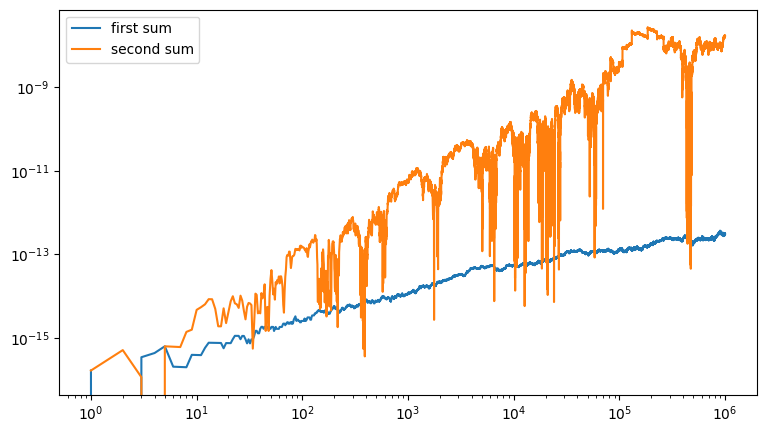

In [34]:
fig_err, ax_err = plt.subplots(figsize = (9,5))

ax_err.plot(N_plot,abs((sum_1 - sum_3)/sum_3))
ax_err.plot(N_plot,abs((sum_2 - sum_3)/sum_3))
ax_err.legend(["first sum", "second sum"])
ax_err.set_xscale('log')
ax_err.set_yscale('log')

The error in the second sum is higher, presumably because the numbers are bigger and more similar

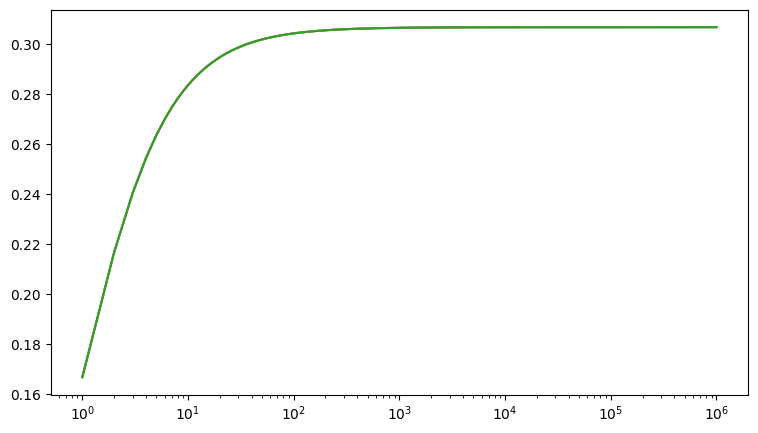

In [42]:
fig, ax = plt.subplots(figsize = (9,5))

ax.plot(N_plot, sum_1)
ax.plot(N_plot, sum_2)
ax.plot(N_plot, sum_3)
ax.set_xscale('log')
#ax.set_yscale('log')